<a href="https://colab.research.google.com/github/Omkar2499/Dataset/blob/main/U_Net_with_vgg.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!unzip -qq Snowy_Sub_Polygons.zip

In [2]:
!pip install segmentation_models_pytorch

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 4.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 109.5/109.5 kB 11.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 44.6 MB/s eta 0:00:00
  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.7.1-py3-none-any.whl size=16424 sha256=3a3110dfd3c7f081a0a357ac50ef5e35c285c4d6fdfcb997e8801a0d0fabe698
  Stored in directory: /root/.cache/pip/wheels/03/3f/e9/911b1bc46869644912bda90a56bcf7b960f20b5187feea3baf
  Created wheel for pretrainedmodels: filename=pretrainedmodels-0.7.4-py3-none-any.whl size=60944 sha256=ad890c5e537986aa3a5515e349f7560a23aca98b9bf91f05fce062ec6f7cdd5e
  Stored in directory: /root/.cache/pip/wheels/35/cb/a5/8f534c60142835bfc889f9a482e4a67e0b817032d9c6883b64
Successfully built efficientnet-pytorc

In [3]:
import os
import cv2
import json
import time
import torch
import random
import numpy as np
import tensorflow as tf
import albumentations as A
import matplotlib.pyplot as plt
import torchvision.models as models
import segmentation_models_pytorch as smp
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Flatten, Dropout
from sklearn.model_selection import train_test_split
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate

/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.21 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [4]:
# Paths to the images and polygon annotations
images_path = '/content/Snowy_Sub_Polygons/Images'
polygons_path = '/content/Snowy_Sub_Polygons/Polygons'

# Output path to store the results
output_path = '/content/output_masks/'
os.makedirs(output_path, exist_ok=True)

In [32]:
class_names = ['Asphalt_wet', 'Black Ice','Cobblestone_wet','Concrete_wet','Gravel_wet','Heavy_Snow','Heavy_wet','Light Snow','Muddy_wet','Packed Snow','Refrozen Ice',
               'Sleet','Slush','Asphalt dry','cobblestone dry','concrete dry','dry mud','gravel dry']

In [6]:
# Define augmentations using Albumentations
transform = A.Compose([
    A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2, p=0.5),
    A.HorizontalFlip(p=0.5),
    A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1, rotate_limit=15, p=0.5),
    A.RandomCrop(height=224, width=224, p=0.5)
])

In [7]:
model = smp.Unet(
    encoder_name="resnet34",  # Choose an encoder
    encoder_weights="imagenet",  # Use pre-trained weights
    in_channels=3,  # Input channels
    classes=1  # Number of output classes
)

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 198MB/s]


In [8]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)
model.eval()

Unet(
  (encoder): ResNetEncoder(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track

In [9]:
baseModel = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

headModel = baseModel.output
headModel = Flatten(name="flatten")(headModel)
headModel = Dense(512, activation="relu")(headModel)
headModel = Dropout(0.5)(headModel) # Add dropout for regularization
headModel = Dense(18, activation="softmax")(headModel) # 18 classes

vgg16_classifier = tf.keras.Model(inputs=baseModel.input, outputs=headModel)

# Freeze the layers in the base model
for layer in baseModel.layers[-4:]:
    layer.trainable = True

# Compile the model
vgg16_classifier.compile(optimizer=Adam(learning_rate=1e-4), loss='categorical_crossentropy', metrics=['accuracy'])
vgg16_classifier.summary()

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 512)                 │      12,845,568 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 27,569,490 (105.17 MB)

 Trainable params: 27,569,490 (105.17 MB)

 Non-trainable params: 0 (0.00 B)

In [10]:
num_random_images = 5

# Function to load an image
def load_image(image_path):
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error: Unable to open image file {image_path}")
    return image

# Function to load and parse JSON data
def load_json(json_file):
    try:
        with open(json_file, 'r') as file:
            data = json.load(file)
        return data
    except (FileNotFoundError, json.JSONDecodeError) as e:
        print(f"Error: {e}")
        return None

In [11]:
# Function to create road masks from JSON annotations
def create_masks(data, height, width):
    predicted_mask_colored = np.zeros((height, width, 3), dtype=np.uint8)
    road_only_mask = np.zeros((height, width, 3), dtype=np.uint8)

    key_value = next((key for key in data['categories'][0] if key == 'name'), None)
    road_annotations = [annotation for annotation in data['annotations'] if annotation['category_id'] == next((category.get('id') for category in data['categories'] if category.get(key_value)), None)]

    for annotation in road_annotations:
        segmentation = annotation['segmentation'][0]
        polygon = np.column_stack((segmentation[::2], segmentation[1::2]))
        polygon = polygon.reshape((-1, 1, 2)).astype(np.int32)
        cv2.fillPoly(predicted_mask_colored, [polygon], (255, 255, 0))  # Deep Yellow for road surfaces
        cv2.fillPoly(road_only_mask, [polygon], (255, 255, 0))

    return predicted_mask_colored, road_only_mask

In [12]:
# Function to apply padding and transformations
def apply_transformations(image):
    height, width, _ = image.shape
    new_height = (height // 32 + 1) * 32 if height % 32 != 0 else height
    new_width = (width // 32 + 1) * 32 if width % 32 != 0 else width
    padded_image = cv2.copyMakeBorder(image, 0, new_height - height, 0, new_width - width, cv2.BORDER_CONSTANT, value=[0, 0, 0])

    transformed = transform(image=padded_image)
    image_transformed = transformed["image"]
    image_transformed = torch.from_numpy(image_transformed).permute(2, 0, 1).unsqueeze(0)
    return image_transformed.type(torch.float32) / 255.0  # Normalize to [0, 1]

In [13]:
def process_prediction(image_transformed):
    with torch.no_grad():
        # Segmentation
        segmentation_prediction = model(image_transformed.to(device))
        segmentation_mask = (segmentation_prediction.squeeze(0).cpu().numpy() > 0.5).astype(np.uint8)

        # Classification
        # Reshape the image_transformed tensor to match the expected input shape of vgg16_classifier
        image_transformed = image_transformed.permute(0, 2, 3, 1) # Change the order of dimensions

        # Convert the PyTorch tensor to a NumPy array
        image_np = image_transformed.cpu().numpy()

        # Perform classification using the TensorFlow model
        classification_prediction = vgg16_classifier(image_np)

        # Convert the TensorFlow tensor to a NumPy array and then to a PyTorch tensor
        predicted_class = torch.tensor(classification_prediction.numpy().argmax(axis=1)[0])
        #predicted_class = torch.argmax(classification_prediction, dim=1).item()

    return segmentation_mask, predicted_class

In [14]:
# Function to create a binary road mask and apply it to the image
def apply_binary_mask(image, road_only_mask):
    gray_road_mask = cv2.cvtColor(road_only_mask, cv2.COLOR_BGR2GRAY)
    binary_road_mask = cv2.threshold(gray_road_mask, 128, 255, cv2.THRESH_BINARY)[1]
    return cv2.bitwise_and(image, image, mask=binary_road_mask)

In [15]:
# Function to visualize and save the results
def visualize_and_save(image, predicted_mask_colored, result, image_name, surface_type, output_path, start_time):
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title(f'Original Image: {image_name}')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(predicted_mask_colored)
    plt.title(f'Predicted Mask\n(Processing Time: {time.time() - start_time:.2f}s)')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(result)
    plt.title(f'Binary Mask\nRoad surface Type: {surface_type.capitalize()}')
    plt.axis('off')

    plt.savefig(os.path.join(output_path, image_name.replace('.png', '_mask.png')))
    plt.show()
    plt.close()

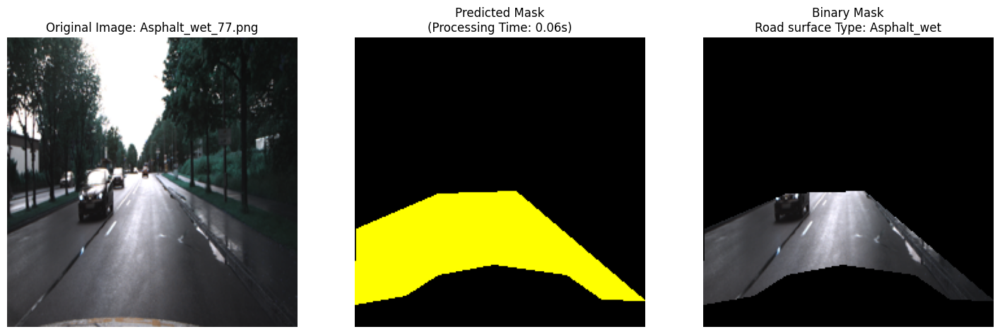

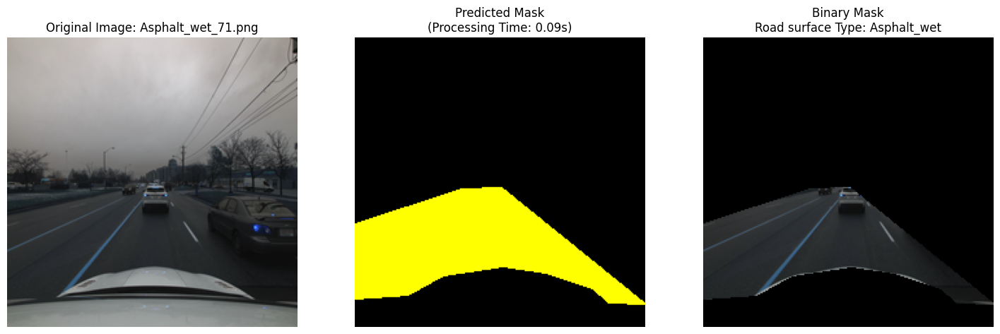

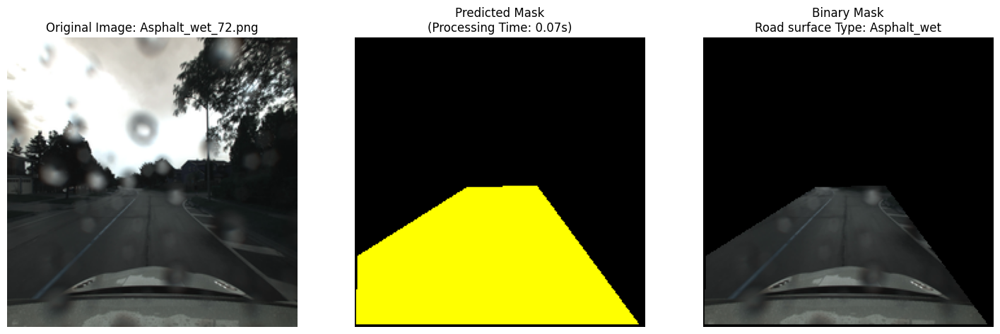

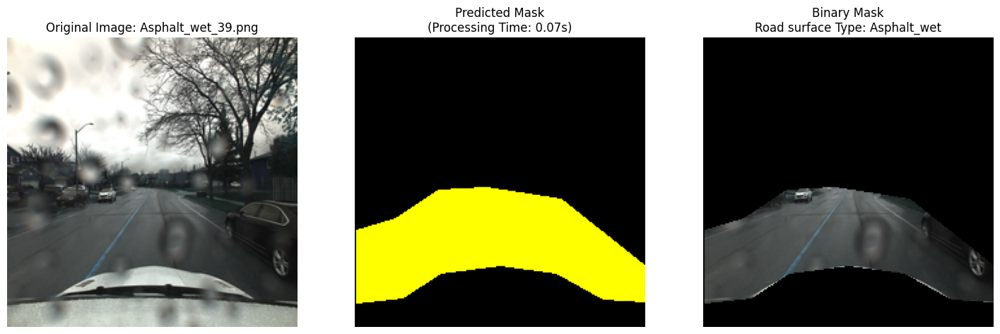

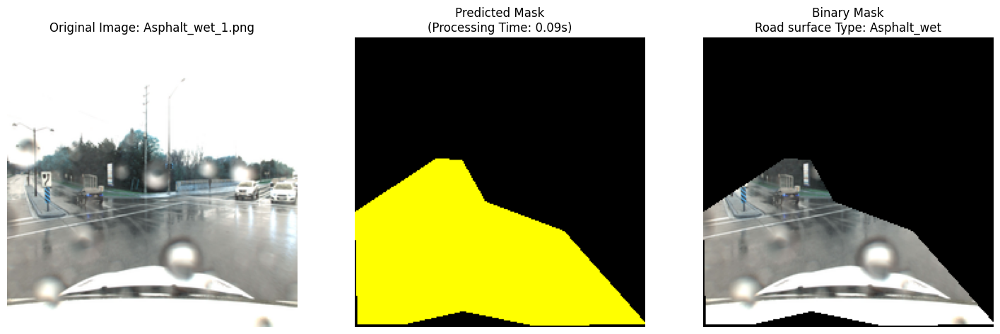

...

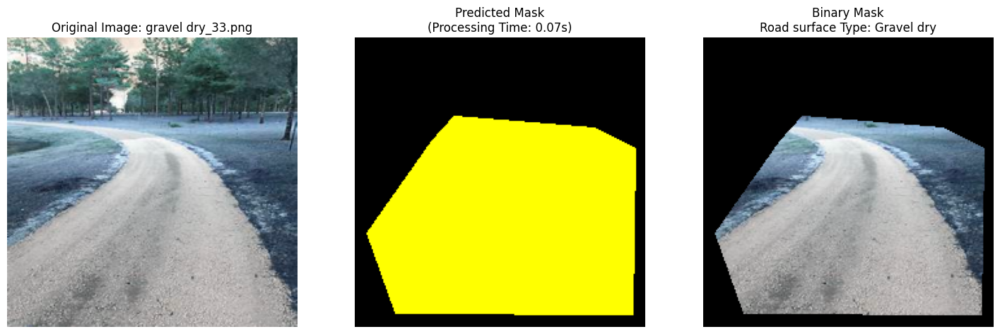

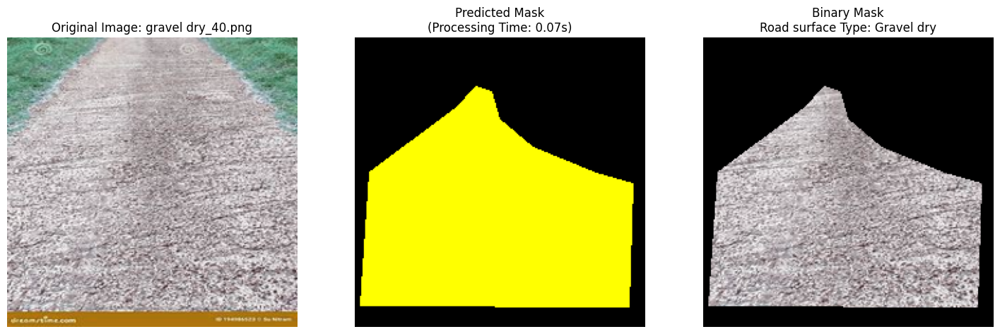

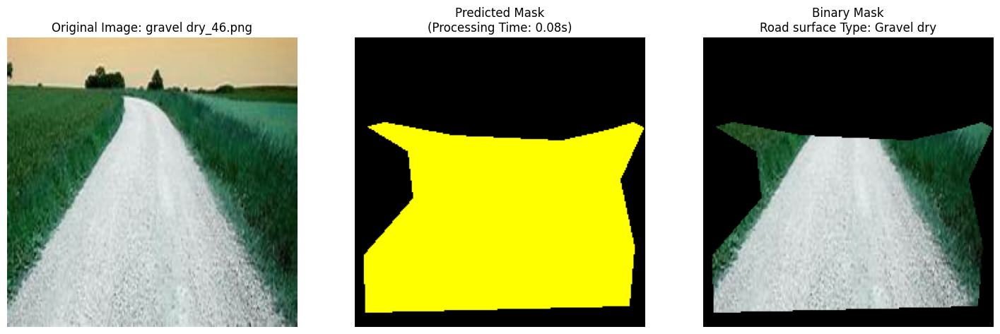

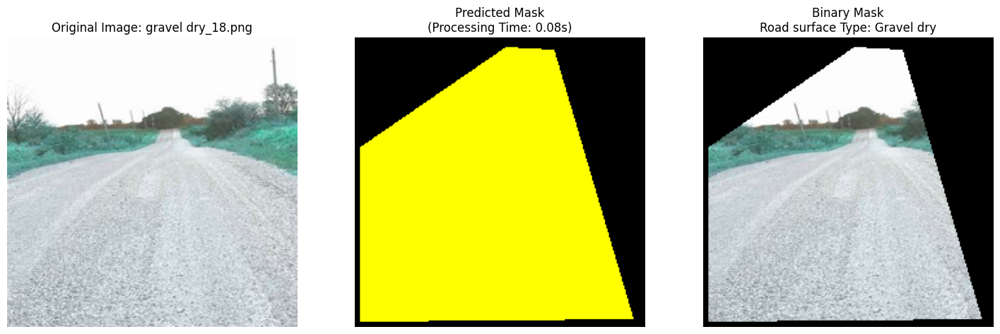

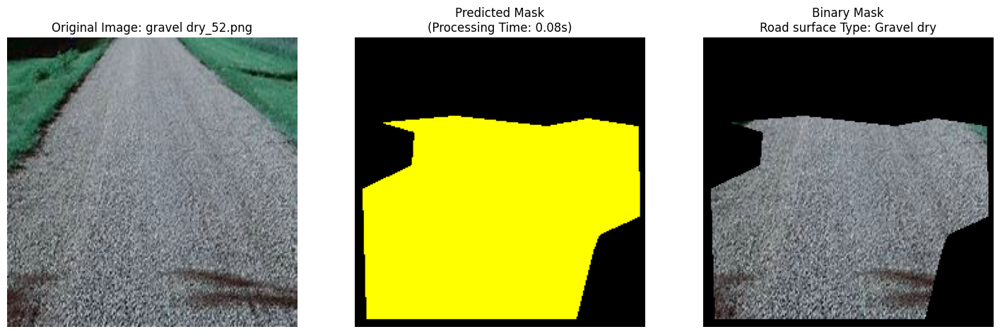

In [33]:
# Main loop for processing images
for surface_type in class_names:
    surface_images_path = os.path.join(images_path, surface_type)
    surface_output_path = os.path.join(output_path, surface_type)
    os.makedirs(surface_output_path, exist_ok=True)

    image_names = [filename for filename in os.listdir(surface_images_path) if filename.endswith('.png')]
    random_image_names = random.sample(image_names, min(num_random_images, len(image_names)))

    for image_name in random_image_names:
        start_time = time.time()
        image_path = os.path.join(surface_images_path, image_name)
        json_file = os.path.join(polygons_path, image_name.replace('.png', '.json'))

        image = load_image(image_path)
        if image is None:
            continue

        data = load_json(json_file)
        if data is None:
            continue

        height, width, _ = image.shape
        predicted_mask_colored, road_only_mask = create_masks(data, height, width)
        image_transformed = apply_transformations(image)

        #predicted_mask = process_prediction(image_transformed)
        predicted_mask, predicted_class = process_prediction(image_transformed)
        result = apply_binary_mask(image, road_only_mask)
        visualize_and_save(image, predicted_mask_colored, result, image_name, surface_type, surface_output_path, start_time)

In [31]:
import os

# Set the path to the directory
dir_path = '/content/Snowy_Sub_Polygons/Images/gravel dry'

# Rename the images in the directory
dir_name = os.path.basename(dir_path)
images = [f for f in os.listdir(dir_path) if f.endswith(('.jpg', '.jpeg', '.png', '.gif', '.bmp'))]
for i, image in enumerate(images):
    file_name, file_extension = os.path.splitext(image)
    new_name = f"{dir_name}_{i+1}{file_extension}"
    os.rename(os.path.join(dir_path, image), os.path.join(dir_path, new_name))


Directory: Slush
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


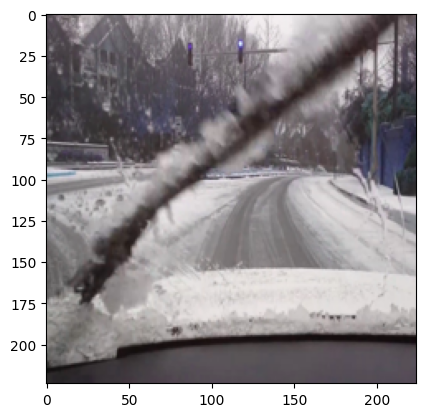

Friction: 0.52617

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


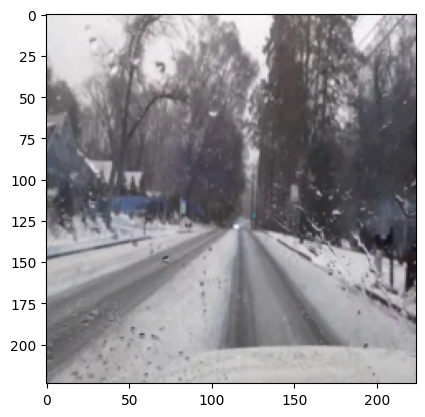

Friction: 0.69100

Directory: Packed Snow
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


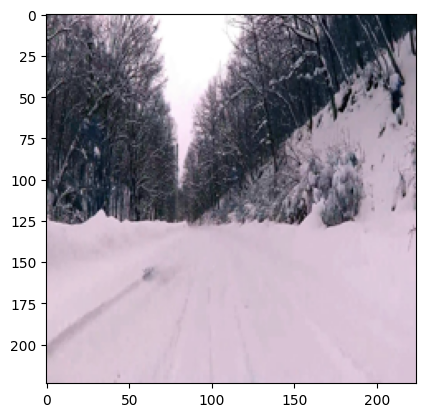

Friction: 0.61983

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


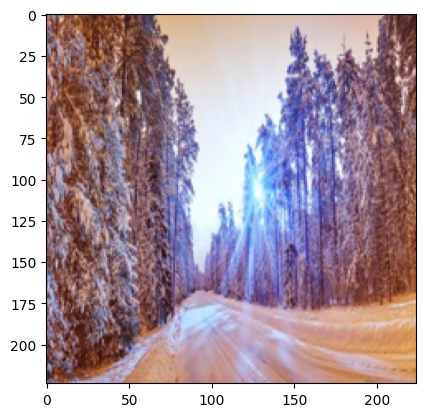

Friction: 0.72417

Directory: Refrozen Ice
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


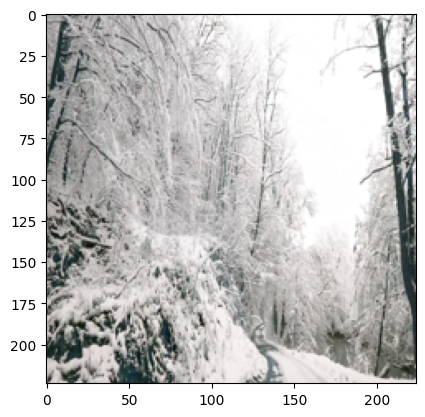

Friction: 0.72174

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


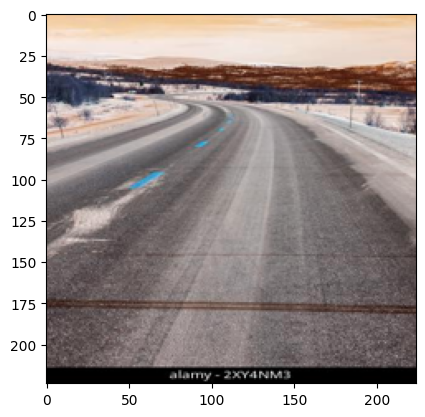

Friction: 0.71889

Directory: Asphalt_wet
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


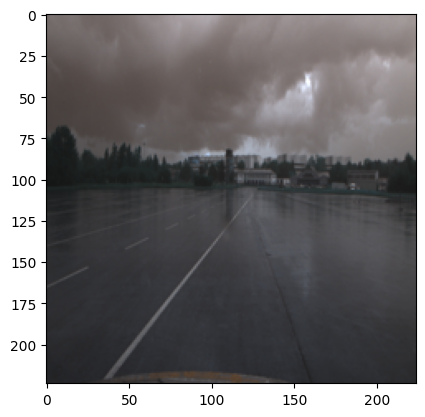

Friction: 0.54300

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


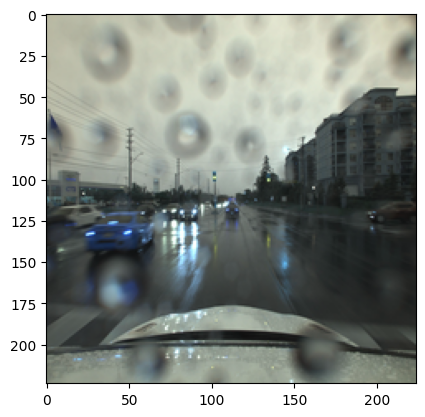

Friction: 0.54070

Directory: Muddy_wet
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


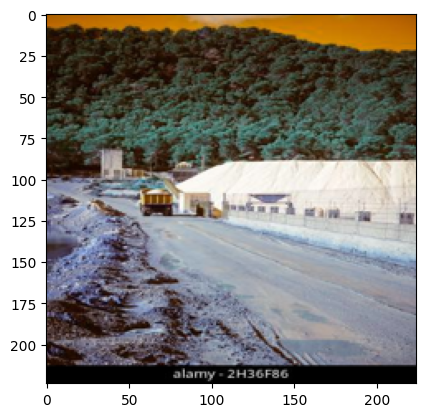

Friction: 0.68577

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


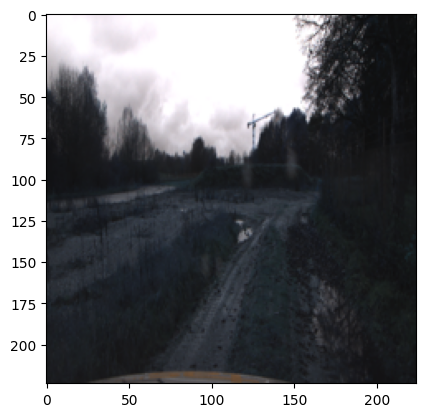

Friction: 0.68482

Directory: Sleet
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


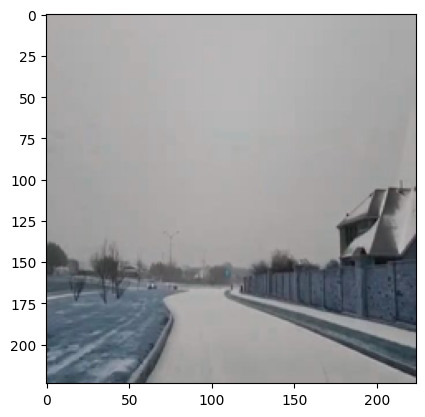

Friction: 0.54964

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


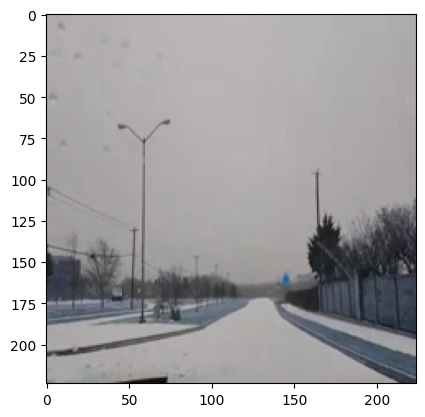

Friction: 0.37751

Directory: Cobblestone_wet
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


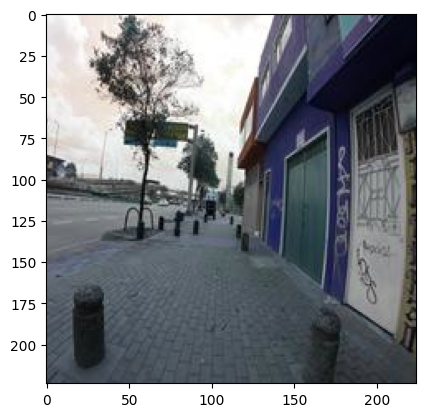

Friction: 0.69984

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


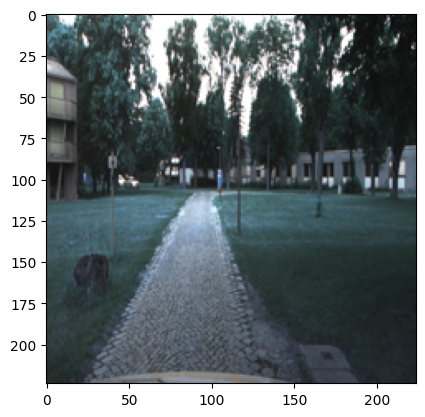

Friction: 0.34304

Directory: Light Snow
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


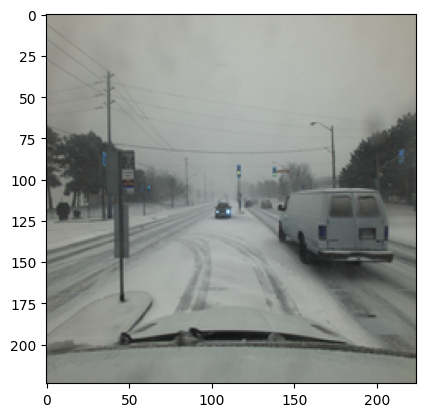

Friction: 0.61882

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


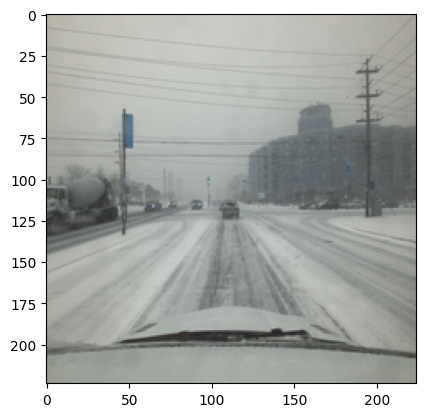

Friction: 0.68133

Directory: concrete dry
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


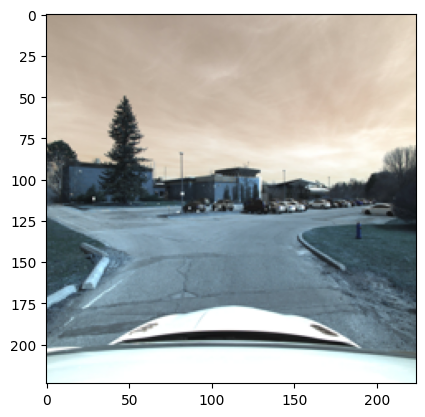

Friction: 0.61273

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


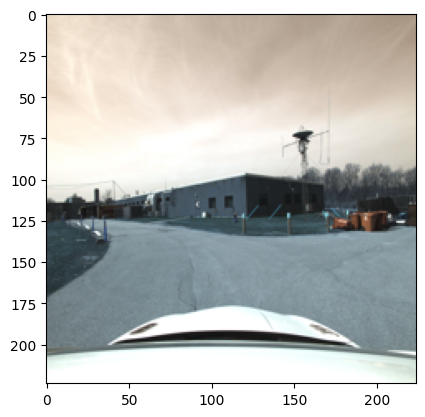

Friction: 0.67240

Directory: .ipynb_checkpoints
Directory: dry mud
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


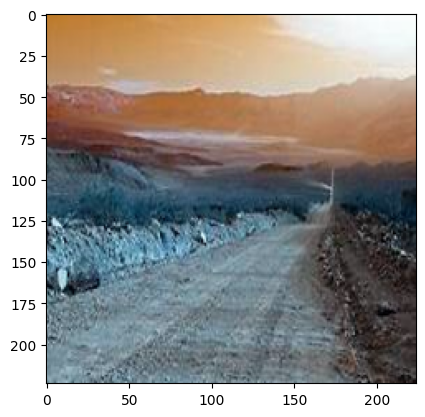

Friction: 0.65896

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


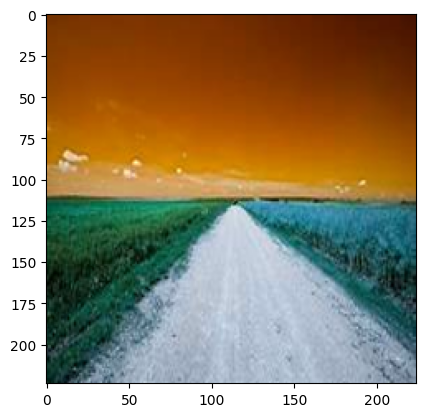

Friction: 0.65454

Directory: gravel dry
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


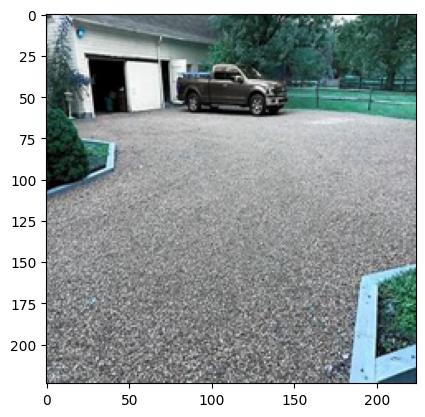

Friction: 0.58792

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


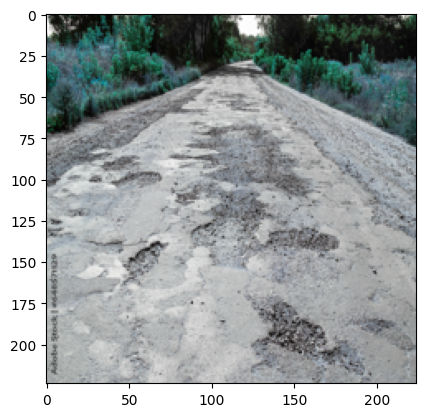

Friction: 0.60386

Directory: Heavy_wet
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


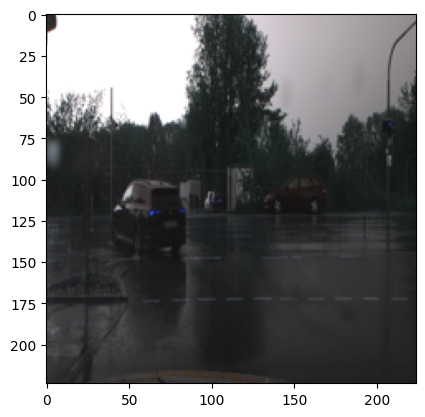

Friction: 0.41497

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


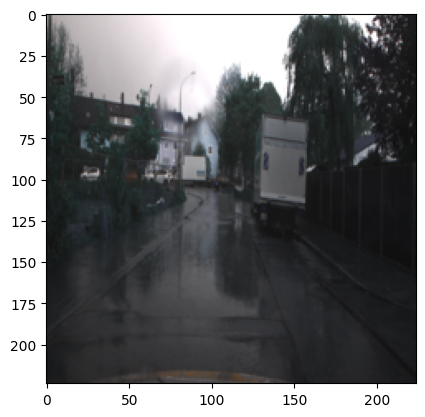

Friction: 0.65457

Directory: Heavy_Snow
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


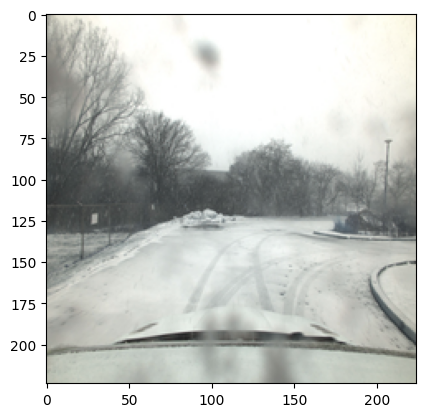

Friction: 0.60874

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


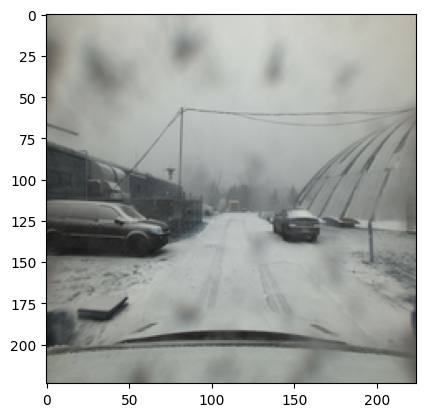

Friction: 0.67707

Directory: Concrete_wet
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


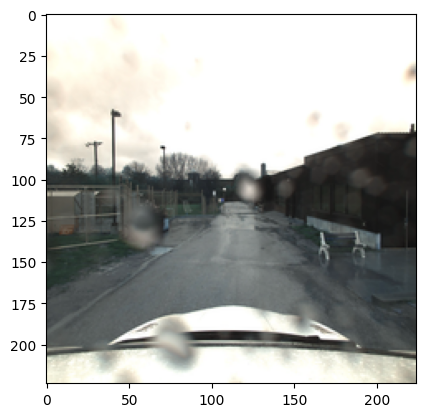

Friction: 0.71604

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


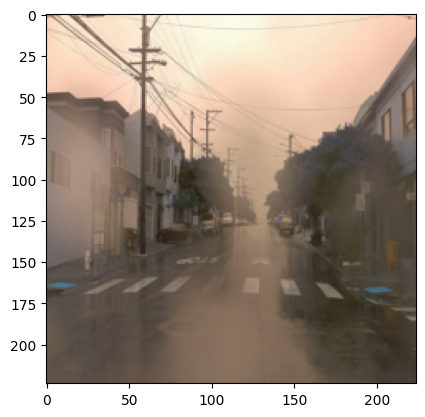

Friction: 0.78002

Directory: Black Ice
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


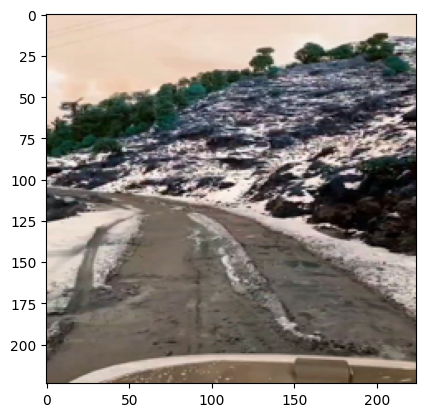

Friction: 0.61273

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


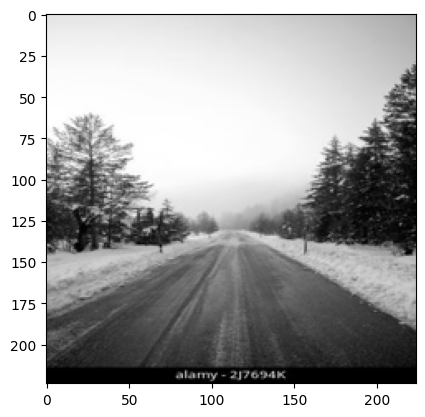

Friction: 0.60519

Directory: Asphalt dry
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


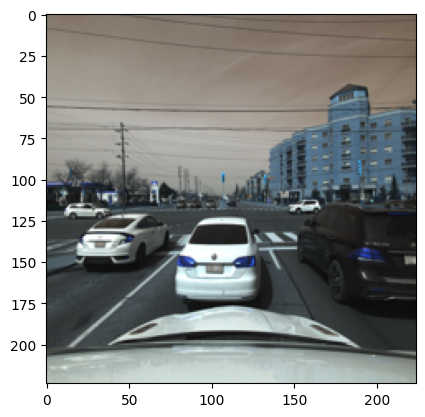

Friction: 0.67886

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


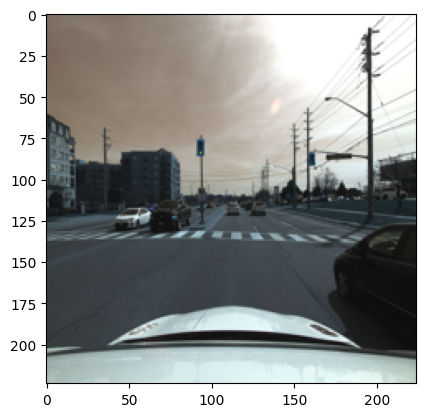

Friction: 0.60011

Directory: Gravel_wet
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


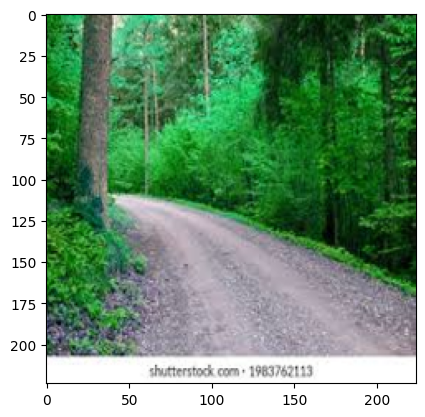

Friction: 0.70713

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


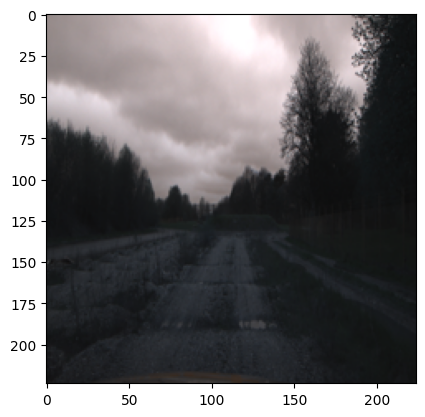

Friction: 0.60925

Directory: cobblestone dry
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


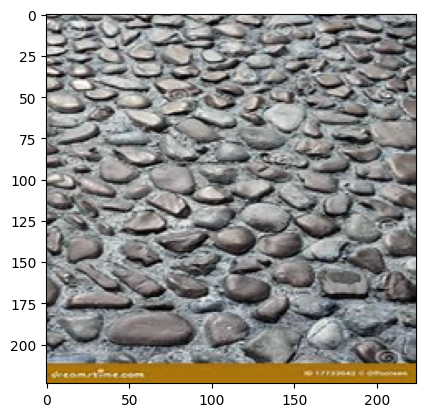

Friction: 0.55732

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


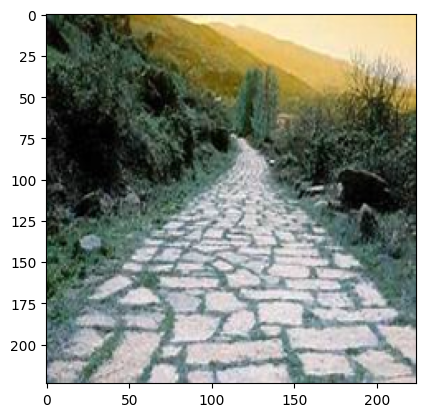

Friction: 0.58171



In [38]:
import tensorflow as tf
import cv2
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import os

# Define class names

# Load the trained model
model = vgg16_classifier

# Define friction coefficients
friction_coefficients = {
    "Asphalt_wet" :"0.40-0.50",
    "Black Ice": "0.005-0.02",
    "Cobblestone_wet" : "0.30-0.40",
    "Concrete_wet" : "0.40-0.50",
    "Gravel_wet" : "0.30-0.40",
    "Heavy_Snow": "0.15-0.30",
    "Heavy_wet" :  "0.30-0.50",
    "Light Snow": "0.05-0.20",
    "Muddy_wet" :   "0.20-0.30",
    "Packed_Snow": "0.05-0.15",
    "Refrozen_Ice": "0.30-0.40",
    "Sleet": "0.50",
    "Slush": "0.35-0.40",
    "Asphalt dry" : "0.70-0.80",
    "cobblestone dry" : "0.60-0.70",
    "concrete dry" :  "0.70-0.80",
    "dry mud" :  "0.50-0.60",
    "gravel dry" : "0.60-0.70"
}

# Define slip ratios, and T values
slip_ratios = {
    "Asphalt_wet" :"0.10-0.20",
    "Black Ice": "0.01-0.10",
    "Cobblestone_wet" : "0.14-0.20",
    "Concrete_wet" : "0.10-0.30",
    "Gravel_wet" : "0.15-0.25",
    "Heavy_Snow": "0.20-0.40",
    "Heavy_wet" :  "0.30-0.40",
    "Light Snow": "0.25-0.40",
    "Muddy_wet" :   "0.40-0.60",
    "Packed_Snow": "0.01-0.10",
    "Refrozen_Ice": "0.05-0.20",
    "Sleet": "0.15-0.30",
    "Slush": "0.10-0.30",
    "Asphalt dry" : "0.20-0.30",
    "cobblestone dry" : "0.30-0.40",
    "concrete dry" :  "0.20-0.30",
    "dry mud" :  "0.25-0.35",
    "gravel dry" : "0.40-0.50"
}
T_values = {
    "Black Ice": 0,
    "Packed_Snow": 0,
    "Refrozen_Ice": 0,
    "Sleet": 0,
    "Slush": 0,
    "Black_Ice": 0,
    "Light Snow" : 0,
    "Heavy_Snow": 0,
    "Cobblestone_wet" : 5,
    "Concrete_wet" : 5,
    "Gravel_wet" : 5,
    "Asphalt_wet" :5,
    "Muddy_wet" :   5,
    "Heavy_wet" :  5,
    "Asphalt dry" : 15,
    "cobblestone dry" : 15,
    "concrete dry" :  15,
    "dry mud" :  15,
    "gravel dry" : 15
}

# Specify the directory path
dir_path = "/content/Snowy_Sub_Polygons/Images"

# Get a list of all directories
directories = [f for f in os.listdir(dir_path) if os.path.isdir(os.path.join(dir_path, f))]

for directory in directories:
    print(f"Directory: {directory}")

    # Get a list of all images in the directory
    image_paths = [os.path.join(dir_path, directory, f) for f in os.listdir(os.path.join(dir_path, directory)) if f.endswith('.png')][:2]

    for image_path in image_paths:
        # Read the image using OpenCV
        img = cv2.imread(image_path)

        # Convert the image to RGB format (assuming the model expects RGB input)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Resize the image to the expected input size (assuming 224x224)
        img_resized = cv2.resize(img_rgb, (224, 224))

        # Expand the dimensions to include the batch size (required for model prediction)
        img_input = np.expand_dims(img_resized, axis=0) / 255.0

        # Make predictions
        predictions = model.predict(img_input)

        # Get the predicted class indices and confidences
        predicted_class_indices = np.argsort(predictions[0])[::-1][:3]
        predicted_class_names = [class_names[index] for index in predicted_class_indices]
        confidences = [predictions[0, index] for index in predicted_class_indices]

        # Calculate mu values
        mu_values = []
        for class_name in predicted_class_names:
            friction_coefficient_str = friction_coefficients[class_name]
            friction_coefficient_range = friction_coefficient_str.split('-')
            if len(friction_coefficient_range) == 2:
                mu = (float(friction_coefficient_range[0]) + float(friction_coefficient_range[1])) / 2
            else:
                mu = float(friction_coefficient_range[0])
            mu_values.append(mu)

        # Calculate w values
        T = 20  # Assuming a temperature of 20 degrees Celsius
        w_values = []
        for class_name in predicted_class_names:
            slip_ratio_str = slip_ratios[class_name]
            slip_ratio = float(slip_ratio_str.split('-')[0])
            w = (1.5 - slip_ratio) * (1 + 0.005 * (T + T_values[class_name]))
            w_values.append(w)

        # Calculate friction
        sum_confidences = confidences[0]+confidences[1]+confidences[2]
        friction = w_values[0]*(confidences[0]/sum_confidences)*mu_values[0] + w_values[1]*(confidences[1]/sum_confidences)*mu_values[1] + w_values[2]*(confidences[2]/sum_confidences)*mu_values[2]

        # Display the results
        plt.imshow(img)
        plt.show()
        print(f"Friction: {friction:.5f}\n")


In [1]:
#  Define friction coefficients
import tensorflow as tf
import cv2
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

# Define class names

# Load the trained model
model = vgg16_classifier

# Specify the image path
img_path = "/content/Snowy_Sub_Polygons/Images/Asphalt dry/Asphalt dry_1.png"

# Read the image using OpenCV
img = cv2.imread(img_path)

# Convert the image to RGB format (assuming the model expects RGB input)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Resize the image to the expected input size (assuming 224x224)
img_resized = cv2.resize(img_rgb, (224, 224))

# Expand the dimensions to include the batch size (required for model prediction)
img_input = np.expand_dims(img_resized, axis=0) / 255.0

# Make predictions
predictions = model.predict(img_input)



# Get the predicted class indices and confidences
predicted_class_indices = np.argsort(predictions[0])[::-1][:3]
predicted_class_names = [class_names[index] for index in predicted_class_indices]
confidences = [predictions[0, index] for index in predicted_class_indices]

# Calculate mu values
mu_values = []
for class_name in predicted_class_names:
    friction_coefficient_str = friction_coefficients[class_name]
    friction_coefficient_range = friction_coefficient_str.split('-')
    if len(friction_coefficient_range) == 2:
        mu = (float(friction_coefficient_range[0]) + float(friction_coefficient_range[1])) / 2
    else:
        mu = float(friction_coefficient_range[0])
    mu_values.append(mu)

friction_coefficients = {
    "Asphalt_wet" :"0.40-0.50",
    "Black Ice": "0.005-0.02",
    "Cobblestone_wet" : "0.30-0.40",
    "Concrete_wet" : "0.40-0.50",
    "Gravel_wet" : "0.30-0.40",
    "Heavy_Snow": "0.15-0.30",
    "Heavy_wet" :  "0.30-0.50",
    "Light Snow": "0.05-0.20",
    "Muddy_wet" :   "0.20-0.30",
    "Packed_Snow": "0.05-0.15",
    "Refrozen_Ice": "0.30-0.40",
    "Sleet": "0.50",
    "Slush": "0.35-0.40",
    "Asphalt dry" : "0.70-0.80",
    "cobblestone dry" : "0.60-0.70",
    "concrete dry" :  "0.70-0.80",
    "dry mud" :  "0.50-0.60",
    "gravel dry" : "0.60-0.70"
}

# Define slip ratios, and T values
slip_ratios = {
    "Asphalt_wet" :"0.10-0.20",
    "Black Ice": "0.01-0.10",
    "Cobblestone_wet" : "0.14-0.20",
    "Concrete_wet" : "0.10-0.30",
    "Gravel_wet" : "0.15-0.25",
    "Heavy_Snow": "0.20-0.40",
    "Heavy_wet" :  "0.30-0.40",
    "Light Snow": "0.25-0.40",
    "Muddy_wet" :   "0.40-0.60",
    "Packed_Snow": "0.01-0.10",
    "Refrozen_Ice": "0.05-0.20",
    "Sleet": "0.15-0.30",
    "Slush": "0.10-0.30",
    "Asphalt dry" : "0.20-0.30",
    "cobblestone dry" : "0.30-0.40",
    "concrete dry" :  "0.20-0.30",
    "dry mud" :  "0.25-0.35",
    "gravel dry" : "0.40-0.50"
}
T_values = {
    "Black Ice": 0,
    "Packed_Snow": 0,
    "Refrozen_Ice": 0,
    "Sleet": 0,
    "Slush": 0,
    "Black_Ice": 0,
    "Light Snow" : 0,
    "Heavy_Snow": 0,
    "Cobblestone_wet" : 5,
    "Concrete_wet" : 5,
    "Gravel_wet" : 5,
    "Asphalt_wet" :5,
    "Muddy_wet" :   5,
    "Heavy_wet" :  5,
    "Asphalt dry" : 15,
    "cobblestone dry" : 15,
    "concrete dry" :  15,
    "dry mud" :  15,
    "gravel dry" : 15
}

# Calculate w values
T = 20  # Assuming a temperature of 20 degrees Celsius
w_values = []
for class_name in predicted_class_names:
    slip_ratio_str = slip_ratios[class_name]
    slip_ratio = float(slip_ratio_str.split('-')[0])
    w = (1.5 - slip_ratio) * (1 + 0.005 * (T + T_values[class_name]))
    w_values.append(w)


sum_confidences = confidences[0]+confidences[1]+confidences[2]
# Calculate friction
friction = w_values[0]*(confidences[0]/sum_confidences)*mu_values[0] + w_values[1]*(confidences[1]/sum_confidences)*mu_values[1] + w_values[2]*(confidences[2]/sum_confidences)*mu_values[2]


plt.imshow(img)
# Print friction
print("Friction:")
print(f"{friction:.5f}")
print(predicted_class_names)
print(predicted_class_indices)

NameError: name 'vgg16_classifier' is not defined